In [1]:
import numpy as np
import pandas as pd 
from sklearn.model_selection import train_test_split, GridSearchCV,cross_val_score, RandomizedSearchCV
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt
from sklearn.preprocessing import scale 
from sklearn import model_selection
from sklearn.tree import DecisionTreeRegressor, DecisionTreeClassifier
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import BaggingRegressor

from warnings import filterwarnings
filterwarnings('ignore')

In [2]:
data = pd.read_csv('insurance.csv')

In [3]:
df_encoded = pd.get_dummies(data, columns=['sex', 'smoker', 'region'])
df_encoded = df_encoded.astype(int)

# Create new columns is_north and is_west
df_encoded['is_north'] = data['region'].isin(['northeast', 'northwest']).astype(int)
df_encoded['is_west'] = data['region'].isin(['northwest', 'southwest']).astype(int)

# Drop unnecessary columns
df_encoded.drop(['sex_male', 'smoker_no', 'region_northeast', 'region_northwest', 'region_southeast', 'region_southwest'], axis=1, inplace=True)

df_encoded

,age,bmi,children,charges,sex_female,smoker_yes,is_north,is_west
0,19,27,0,16884,1,1,0,1
1,18,33,1,1725,0,0,0,0
2,28,33,3,4449,0,0,0,0
3,33,22,0,21984,0,0,1,1
4,32,28,0,3866,0,0,1,1
...,...,...,...,...,...,...,...,...
1333,50,30,3,10600,0,0,1,1
1334,18,31,0,2205,1,0,1,0
1335,18,36,0,1629,1,0,0,0
1336,21,25,0,2007,1,0,0,1


# KNN

In [4]:
df = df_encoded
X = df.drop("charges", axis = 1)
y = df["charges"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state= 42)
print("X_train", X_train.shape)
print("y_train",y_train.shape)
print("X_test",X_test.shape)
print("y_test",y_test.shape)

X_train (1070, 7)
y_train (1070,)
X_test (268, 7)
y_test (268,)


In [5]:
knn_model = KNeighborsRegressor().fit(X_train, y_train)

In [6]:
knn_model

KNeighborsRegressor()

In [7]:
knn_model.n_neighbors

5

In [8]:
knn_model.effective_metric_

'euclidean'

In [9]:
y_pred = knn_model.predict(X_test)

In [10]:
np.sqrt(mean_squared_error(y_test, y_pred))

10975.452417459175

In [11]:
r2_score(y_test, y_pred)

0.22407868947809784

In [12]:
RMSE = [] 

for k in range(10):
    k = k+1
    knn_model = KNeighborsRegressor(n_neighbors = k).fit(X_train, y_train)
    y_pred = knn_model.predict(X_train) 
    rmse = np.sqrt(mean_squared_error(y_train,y_pred)) 
    RMSE.append(rmse) 
    print("k =" , k , "için RMSE değeri: ", rmse)

k = 1 için RMSE değeri:  949.949910140372
k = 2 için RMSE değeri:  6473.754277761226
k = 3 için RMSE değeri:  7962.866991159609
k = 4 için RMSE değeri:  8755.614567389712
k = 5 için RMSE değeri:  9266.636077941625
k = 6 için RMSE değeri:  9538.56620283233
k = 7 için RMSE değeri:  9790.580870003425
k = 8 için RMSE değeri:  9943.495785003746
k = 9 için RMSE değeri:  10005.619453970205
k = 10 için RMSE değeri:  10036.917407446697


## Tuning

In [13]:
from sklearn.model_selection import GridSearchCV

In [14]:
knn_params = {'n_neighbors': np.arange(1,30,1)}

In [15]:
knn = KNeighborsRegressor()

In [16]:
knn_cv_model = GridSearchCV(knn, knn_params, cv = 10)

In [17]:
knn_cv_model.fit(X_train, y_train)

GridSearchCV(cv=10, estimator=KNeighborsRegressor(),
             param_grid={'n_neighbors': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29])})

In [18]:
knn_cv_model.best_params_["n_neighbors"]

18

In [19]:
RMSE = [] 
RMSE_CV = []
for k in range(10):
    k = k+1
    knn_model = KNeighborsRegressor(n_neighbors = k).fit(X_train, y_train)
    y_pred = knn_model.predict(X_train) 
    rmse = np.sqrt(mean_squared_error(y_train,y_pred)) 
    rmse_cv = np.sqrt(-1*cross_val_score(knn_model, X_train, y_train, cv=10, 
                                         scoring = "neg_mean_squared_error").mean())
    RMSE.append(rmse) 
    RMSE_CV.append(rmse_cv)
    print("k =" , k , "için RMSE değeri: ", rmse, "RMSE_CV değeri: ", rmse_cv )


k = 1 için RMSE değeri:  949.949910140372 RMSE_CV değeri:  13389.409533545882
k = 2 için RMSE değeri:  6473.754277761226 RMSE_CV değeri:  11919.236229490232
k = 3 için RMSE değeri:  7962.866991159609 RMSE_CV değeri:  11803.86343336277
k = 4 için RMSE değeri:  8755.614567389712 RMSE_CV değeri:  11580.379789935527
k = 5 için RMSE değeri:  9266.636077941625 RMSE_CV değeri:  11525.543757784191
k = 6 için RMSE değeri:  9538.56620283233 RMSE_CV değeri:  11434.010097359373
k = 7 için RMSE değeri:  9790.580870003425 RMSE_CV değeri:  11380.478301245314
k = 8 için RMSE değeri:  9943.495785003746 RMSE_CV değeri:  11264.863900396263
k = 9 için RMSE değeri:  10005.619453970205 RMSE_CV değeri:  11165.941537076711
k = 10 için RMSE değeri:  10036.917407446697 RMSE_CV değeri:  11198.474971416388


In [20]:
knn_tuned = KNeighborsRegressor(n_neighbors = knn_cv_model.best_params_["n_neighbors"])

In [21]:
knn_tuned.fit(X_train, y_train)

KNeighborsRegressor(n_neighbors=18)

In [36]:
msre_knn = np.sqrt(mean_squared_error(y_test, knn_tuned.predict(X_test)))
msre_knn

12216.657379049702

In [34]:
r2_knn = r2_score(y_test, knn_tuned.predict(X_test))
r2_knn

0.038658688657642104

## Scaling Data

In [26]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(X_train)
X_train_scaled = scaler.transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [27]:
knn = KNeighborsRegressor()
knn_cv_model = GridSearchCV(knn, knn_params, cv = 10)
knn_cv_model.fit(X_train_scaled, y_train)
knn_cv_model.best_params_["n_neighbors"]

10

In [28]:
knn_tuned = KNeighborsRegressor(n_neighbors = knn_cv_model.best_params_["n_neighbors"])
knn_tuned.fit(X_train_scaled, y_train)

KNeighborsRegressor(n_neighbors=10)

In [37]:
msre_knn = np.sqrt(mean_squared_error(y_test, knn_tuned.predict(X_test_scaled)))
msre_knn

5537.457793353521

In [38]:
r2_knn = r2_score(y_test, knn_tuned.predict(X_test_scaled))
r2_knn

0.8024879141777762

# SVR

In [39]:
df = df_encoded
X = df
y = df["charges"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state= 42)
print("X_train", X_train.shape)
print("y_train",y_train.shape)
print("X_test",X_test.shape)
print("y_test",y_test.shape)

X_train (1070, 8)
y_train (1070,)
X_test (268, 8)
y_test (268,)


In [40]:
X_train = pd.DataFrame(X_train["age"])
X_test = pd.DataFrame(X_test["age"])

In [41]:
from sklearn.svm import SVR

In [42]:
svr_model = SVR(kernel="linear", C=100, gamma="auto").fit(X_train, y_train)

In [43]:
svr_model.predict(X_train)[0:5]

array([ 9192.9       ,  9460.35714286, 10797.64285714,  7320.7       ,
       11332.55714286])

In [44]:
y_pred = svr_model.predict(X_train)

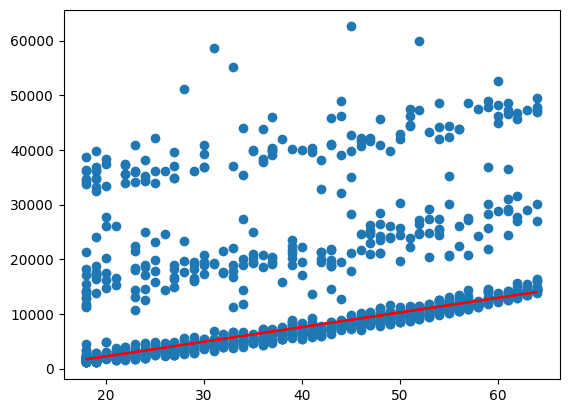

In [45]:
plt.scatter(X_train, y_train)
plt.plot(X_train,y_pred, color = "r")

In [46]:
from sklearn.linear_model import LinearRegression
lm_model = LinearRegression().fit(X_train, y_train)
lm_pred  = lm_model.predict(X_train)
print("y = {0} + {1} x".format(lm_model.intercept_, lm_model.coef_[0]))

y = 3876.4047054329785 + 240.5973348496085 x


Text(0, 0.5, 'Charge')

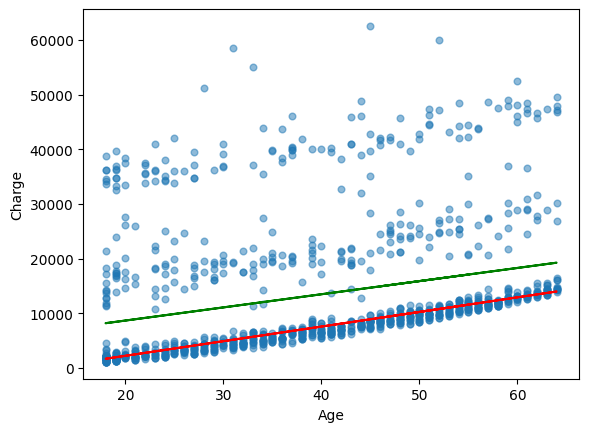

In [47]:
plt.scatter(X_train, y_train, alpha=0.5, s=23)
plt.plot(X_train, lm_pred, 'g')
plt.plot(X_train, y_pred, color='r')

plt.xlabel("Age")
plt.ylabel("Charge")

## Estimate

In [48]:
print ("y = {0} + {1} x".format(svr_model.intercept_, svr_model.coef_)) 

y = [-3110.12857143] + [[267.45714286]] x


In [49]:
svr_model.predict([[30]])

array([4913.58571429])

In [50]:
y_pred = svr_model.predict(X_test)

In [51]:
np.sqrt(mean_squared_error(y_test, y_pred))

12971.878768328466

In [52]:
svr_model

SVR(C=100, gamma='auto', kernel='linear')

## Multi Input SVR

In [53]:
df = df_encoded
X = df.drop("charges", axis = 1)
y = df["charges"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state= 42)
print("X_train", X_train.shape)
print("y_train",y_train.shape)
print("X_test",X_test.shape)
print("y_test",y_test.shape)

X_train (1070, 7)
y_train (1070,)
X_test (268, 7)
y_test (268,)


In [54]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(X_train)
X_train_scaled = scaler.transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [55]:
svr_model = SVR(kernel="linear", C=100, gamma="auto").fit(X_train_scaled, y_train)

In [56]:
y_pred = svr_model.predict(X_test_scaled)

In [57]:
np.sqrt(mean_squared_error(y_test, y_pred))

7358.36846296649

## Tuning

range is adjusted manually until r2 is good enough

In [58]:
svr_params = {"C": np.arange(180,200,0.1)}
svr_cv_model = GridSearchCV(svr_model, svr_params, cv = 10,n_jobs=-1).fit(X_train_scaled,y_train)

In [59]:
pd.Series(svr_cv_model.best_params_)

C    193.0
dtype: float64

In [60]:
svr_tuned = SVR(kernel="linear", 
                C = pd.Series(svr_cv_model.best_params_)[0]).fit(X_train_scaled, y_train)

In [61]:
y_pred = svr_tuned.predict(X_test_scaled)

In [64]:
msre_multi_svr = np.sqrt(mean_squared_error(y_test, y_pred))
msre_multi_svr

6170.531317859868

In [65]:
r2_multi_svr =r2_score(y_test, y_pred)
r2_multi_svr

0.7547449610561272

# MLP

In [66]:
df = df_encoded
X = df.drop("charges", axis = 1)
y = df["charges"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state= 42)
print("X_train", X_train.shape)
print("y_train",y_train.shape)
print("X_test",X_test.shape)
print("y_test",y_test.shape)

X_train (1070, 7)
y_train (1070,)
X_test (268, 7)
y_test (268,)


In [67]:
scaler = StandardScaler()
scaler.fit(X_train)
X_train_scaled = scaler.transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [68]:
from sklearn.neural_network import MLPRegressor

In [69]:
mlp_model = MLPRegressor(hidden_layer_sizes = (100,20)).fit(X_train_scaled, y_train)

In [70]:
mlp_model

MLPRegressor(hidden_layer_sizes=(100, 20))

In [71]:
mlp_model.n_layers_

4

In [72]:
mlp_model.hidden_layer_sizes

(100, 20)

In [73]:
y_pred = mlp_model.predict(X_test_scaled)

In [74]:
np.sqrt(mean_squared_error(y_test, y_pred))

6556.713790885032

## Tuning

In [75]:
mlp_params = {'alpha': [0.1, 0.01,0.02,0.005],
             'hidden_layer_sizes': [(20,20),(100,50,150),(300,200,150)],
             'activation': ['relu','logistic']}

In [76]:
mlp_cv_model = GridSearchCV(mlp_model, mlp_params, cv = 10, n_jobs=-1)

In [77]:
mlp_cv_model.fit(X_train_scaled, y_train)

/Users/onur/.pyenv/versions/3.11.2/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/onur/.pyenv/versions/3.11.2/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/onur/.pyenv/versions/3.11.2/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/onur/.pyenv/versions/3.11.2/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  war

GridSearchCV(cv=10, estimator=MLPRegressor(hidden_layer_sizes=(100, 20)),
             n_jobs=-1,
             param_grid={'activation': ['relu', 'logistic'],
                         'alpha': [0.1, 0.01, 0.02, 0.005],
                         'hidden_layer_sizes': [(20, 20), (100, 50, 150),
                                                (300, 200, 150)]})

In [78]:
mlp_cv_model.best_params_

{'activation': 'relu', 'alpha': 0.01, 'hidden_layer_sizes': (300, 200, 150)}

In [79]:
mlp_tuned = MLPRegressor(alpha = 0.01, hidden_layer_sizes = (300,200,150))

In [80]:
mlp_tuned.fit(X_train_scaled, y_train)

MLPRegressor(alpha=0.01, hidden_layer_sizes=(300, 200, 150))

In [81]:
y_pred = mlp_tuned.predict(X_test_scaled)

In [84]:
msre_mlp =np.sqrt(mean_squared_error(y_test, y_pred))
msre_mlp

4709.280167208081

In [85]:
r2_mlp = r2_score(y_test, y_pred)
r2_mlp

0.8571494639837863

# CART

In [86]:
df = df_encoded
X = df.drop("charges", axis = 1)
y = df["charges"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state= 42)
print("X_train", X_train.shape)
print("y_train",y_train.shape)
print("X_test",X_test.shape)
print("y_test",y_test.shape)

X_train (1070, 7)
y_train (1070,)
X_test (268, 7)
y_test (268,)


In [87]:
cart_model = DecisionTreeRegressor(min_samples_split = 2)

In [88]:
cart_model.fit(X_train, y_train)

DecisionTreeRegressor()

In [89]:
from skompiler import skompile

In [90]:
print(skompile(cart_model.predict).to('python/code'))

((((((((((1121.0 if x[3] <= 0.5 else 1607.0 if x[1] <= 23.0 else 1615.0) if
    x[5] <= 0.5 else (1694.0 if x[1] <= 18.5 else (1704.0 if x[1] <= 22.5 else
    1704.5) if x[1] <= 24.0 else 1708.0 if x[1] <= 26.5 else 1712.0) if x[3
    ] <= 0.5 else 2196.0 if x[1] <= 26.5 else 2200.0) if x[0] <= 19.0 else 
    ((1515.0 if x[0] <= 21.5 else 1664.0) if x[5] <= 0.5 else (1967.0 if x[
    0] <= 20.5 else 2102.0 if x[1] <= 26.5 else 2104.0) if x[0] <= 21.5 else
    2250.0) if x[3] <= 0.5 else 2155.5 if x[5] <= 0.5 else 2457.0 if x[0] <=
    20.5 else 2585.0) if x[1] <= 29.0 else (8583.333333333334 if x[0] <= 
    19.0 else 2459.0 if x[0] <= 21.0 else 2741.0) if x[1] <= 30.5 else ((((
    (1135.5 if x[1] <= 33.5 else 1137.0) if x[1] <= 35.5 else 1141.0) if x[
    3] <= 0.5 else ((1621.5 if x[0] <= 19.0 else 1877.0) if x[5] <= 0.5 else
    2205.0) if x[1] <= 32.0 else (11482.0 if x[5] <= 0.5 else 2207.0) if x[
    1] <= 34.0 else 2211.0 if x[1] <= 35.5 else 1629.0) if x[1] <= 37.5 else
    (57

In [91]:
y_pred =cart_model.predict(X_test)

In [92]:
np.sqrt(mean_squared_error(y_test, y_pred))

6049.763133888869

## Tuning

In [93]:
cart_model = DecisionTreeRegressor()
cart_model.fit(X_train, y_train)
y_pred = cart_model.predict(X_test)

In [94]:
np.sqrt(mean_squared_error(y_test, y_pred))

6361.346860244883

In [95]:
cart_params = {"min_samples_split": range(2,100),
               "max_leaf_nodes": range(2,10)}

In [96]:
cart_cv_model = GridSearchCV(cart_model, cart_params, cv = 10)

In [97]:
cart_cv_model.fit(X_train, y_train)

GridSearchCV(cv=10, estimator=DecisionTreeRegressor(),
             param_grid={'max_leaf_nodes': range(2, 10),
                         'min_samples_split': range(2, 100)})

In [98]:
cart_cv_model.best_params_

{'max_leaf_nodes': 9, 'min_samples_split': 82}

In [99]:
cart_tuned = DecisionTreeRegressor(max_leaf_nodes = 9, min_samples_split = 82)

In [100]:
cart_tuned.fit(X_train, y_train)

DecisionTreeRegressor(max_leaf_nodes=9, min_samples_split=82)

In [101]:
y_pred = cart_tuned.predict(X_test)

In [104]:
msre_cart = np.sqrt(mean_squared_error(y_test, y_pred))
msre_cart

4786.741470580992

In [105]:
r2_cart = r2_score(y_test, y_pred)
r2_cart

0.8524114175449583

# Bagged Trees Regression

In [106]:
df = df_encoded
X = df.drop("charges", axis = 1)
y = df["charges"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state= 42)
print("X_train", X_train.shape)
print("y_train",y_train.shape)
print("X_test",X_test.shape)
print("y_test",y_test.shape)

X_train (1070, 7)
y_train (1070,)
X_test (268, 7)
y_test (268,)


In [107]:
bag_model = BaggingRegressor(bootstrap_features = True)
bag_model.fit(X_train, y_train)

BaggingRegressor(bootstrap_features=True)

In [108]:
bag_model.n_estimators

10

In [109]:
y_pred = bag_model.predict(X_test)

In [110]:
np.sqrt(mean_squared_error(y_test, y_pred))

11713.15259616815

## Tuning

In [111]:
bag_model = BaggingRegressor(bootstrap_features = True)
bag_model.fit(X_train, y_train)

BaggingRegressor(bootstrap_features=True)

In [112]:
bag_params = {"n_estimators": range(2,20)}

In [113]:
bag_cv_model = GridSearchCV(bag_model, bag_params, cv = 10, n_jobs=-1)

In [114]:
bag_cv_model2 = RandomizedSearchCV(bag_model, bag_params, cv = 10)

In [115]:
bag_cv_model.fit(X_train, y_train)
bag_cv_model2.fit(X_train, y_train)

RandomizedSearchCV(cv=10, estimator=BaggingRegressor(bootstrap_features=True),
                   param_distributions={'n_estimators': range(2, 20)})

In [116]:
print("Grid", bag_cv_model.best_params_)
print('Random:', bag_cv_model2.best_params_)

Grid {'n_estimators': 19}
Random: {'n_estimators': 17}


In [118]:
bag_tuned = BaggingRegressor( n_estimators = 19)

In [119]:
bag_tuned.fit(X_train, y_train)

BaggingRegressor(n_estimators=19)

In [120]:
y_pred = bag_tuned.predict(X_test)

In [123]:
msre_bagged = np.sqrt(mean_squared_error(y_test, y_pred))
msre_bagged

4882.595425976583

In [124]:
r2_bagged = r2_score(y_test, y_pred)
r2_bagged

0.8464413458306277

# Random Forest

In [125]:
df = df_encoded
X = df.drop("charges", axis = 1)
y = df["charges"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state= 42)
print("X_train", X_train.shape)
print("y_train",y_train.shape)
print("X_test",X_test.shape)
print("y_test",y_test.shape)

X_train (1070, 7)
y_train (1070,)
X_test (268, 7)
y_test (268,)


In [126]:
from sklearn.ensemble import RandomForestRegressor

In [127]:
rf_model = RandomForestRegressor(random_state = 42)

In [128]:
rf_model.fit(X_train, y_train)

RandomForestRegressor(random_state=42)

In [129]:
y_pred = rf_model.predict(X_test)

In [130]:
np.sqrt(mean_squared_error(y_test, y_pred))

4689.968782451057

# Tuning

In [131]:
rf_params = {'max_depth': list(range(4,6)),
            'max_features': [5,6],
            'n_estimators' : [1800,1900,1950,2000]}

rf_params = {'max_depth': list(range(1,10)),
            'max_features': [3,4,5,10],
            'n_estimators' : [1000, 2000, 3000, 4000]}

In [132]:
rf_model = RandomForestRegressor(random_state = 42)

In [133]:
rf_cv_model = GridSearchCV(rf_model, 
                           rf_params, 
                           cv = 10, 
                            n_jobs = -1)

In [134]:
rf_cv_model.fit(X_train, y_train)

GridSearchCV(cv=10, estimator=RandomForestRegressor(random_state=42), n_jobs=-1,
             param_grid={'max_depth': [4, 5], 'max_features': [5, 6],
                         'n_estimators': [1800, 1900, 1950, 2000]})

In [135]:
rf_cv_model.best_params_

{'max_depth': 5, 'max_features': 5, 'n_estimators': 2000}

initial: {'max_depth': 5, 'max_features': 5, 'n_estimators': 2000}

In [136]:
rf_tuned = RandomForestRegressor(max_depth  = 5, 
                                 max_features = 5, 
                                 n_estimators =2000)

In [137]:
rf_tuned.fit(X_train, y_train)

RandomForestRegressor(max_depth=5, max_features=5, n_estimators=2000)

In [138]:
y_pred = rf_tuned.predict(X_test)

In [143]:
msre_randomf = np.sqrt(mean_squared_error(y_test, y_pred))
msre_randomf

4424.4566336759

In [144]:
r2_randomf =r2_score(y_test,y_pred)
r2_randomf

0.8739064991114166

In [141]:
Importance = pd.DataFrame({"Importance": rf_tuned.feature_importances_*100},
                         index = X_train.columns)

Text(0.5, 0, 'Değişken Önem Düzeyleri')

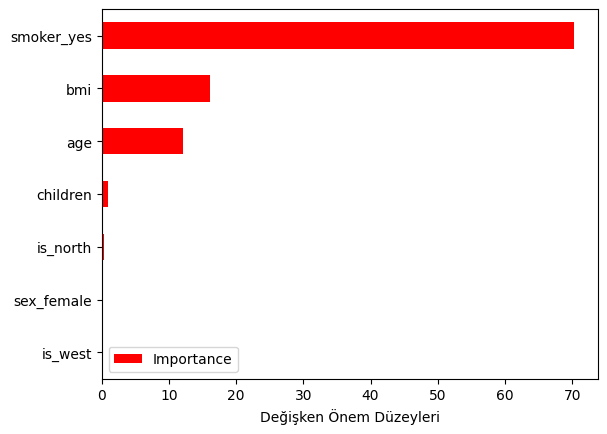

In [142]:
Importance.sort_values(by = "Importance", 
                       axis = 0, 
                       ascending = True).plot(kind ="barh", color = "r")

plt.xlabel("Değişken Önem Düzeyleri")

# Gradient Boosting Machines

In [145]:
df = df_encoded
X = df.drop("charges", axis = 1)
y = df["charges"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state= 42)
print("X_train", X_train.shape)
print("y_train",y_train.shape)
print("X_test",X_test.shape)
print("y_test",y_test.shape)

X_train (1070, 7)
y_train (1070,)
X_test (268, 7)
y_test (268,)


In [146]:
from sklearn.ensemble import GradientBoostingRegressor

In [147]:
gbm_model = GradientBoostingRegressor()
gbm_model.fit(X_train, y_train)

GradientBoostingRegressor()

In [148]:
y_pred = gbm_model.predict(X_test)
np.sqrt(mean_squared_error(y_test, y_pred))

4373.749101381204

In [149]:
gbm_params = {
    'learning_rate': [0.005, 0.01, 0.02,0.05, 0.6],
    'max_depth': [1,2,3,4,5],
    'n_estimators': [200,300,400,500,600,700],
    'subsample': [0.6,0.75, 0.8],
}

In [150]:
gbm = GradientBoostingRegressor()
gbm_cv_model = GridSearchCV(gbm, gbm_params, cv = 10, n_jobs = -1, verbose = 2)
gbm_cv_model.fit(X_train, y_train)

Fitting 10 folds for each of 450 candidates, totalling 4500 fits
[CV] END learning_rate=0.005, max_depth=1, n_estimators=200, subsample=0.6; total time=   0.1s
[CV] END learning_rate=0.005, max_depth=1, n_estimators=200, subsample=0.6; total time=   0.1s
[CV] END learning_rate=0.005, max_depth=1, n_estimators=200, subsample=0.6; total time=   0.1s
[CV] END learning_rate=0.005, max_depth=1, n_estimators=200, subsample=0.6; total time=   0.1s
[CV] END learning_rate=0.005, max_depth=1, n_estimators=200, subsample=0.6; total time=   0.1s
[CV] END learning_rate=0.005, max_depth=1, n_estimators=200, subsample=0.6; total time=   0.1s
[CV] END learning_rate=0.005, max_depth=1, n_estimators=200, subsample=0.6; total time=   0.1s
[CV] END learning_rate=0.005, max_depth=1, n_estimators=200, subsample=0.6; total time=   0.1s
[CV] END learning_rate=0.005, max_depth=1, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.005, max_depth=1, n_estimators=200, subsample=0.75; to

GridSearchCV(cv=10, estimator=GradientBoostingRegressor(), n_jobs=-1,
             param_grid={'learning_rate': [0.005, 0.01, 0.02, 0.05, 0.6],
                         'max_depth': [1, 2, 3, 4, 5],
                         'n_estimators': [200, 300, 400, 500, 600, 700],
                         'subsample': [0.6, 0.75, 0.8]},
             verbose=2)

In [151]:
gbm_cv_model.best_params_

{'learning_rate': 0.02, 'max_depth': 3, 'n_estimators': 200, 'subsample': 0.75}

Initial: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.75} - 4364.191561142799

Second: {'learning_rate': 0.02, 'max_depth': 3, 'n_estimators': 200, 'subsample': 0.6} - 4367.123433967693

In [152]:
gbm_tuned = GradientBoostingRegressor(learning_rate = 0.02,  
                                      max_depth = 3, 
                                      n_estimators = 200, 
                                      subsample = 0.75)

gbm_tuned = gbm_tuned.fit(X_train,y_train)

In [153]:
y_pred = gbm_tuned.predict(X_test)
np.sqrt(mean_squared_error(y_test, y_pred))

4357.690929135165

In [154]:
Importance = pd.DataFrame({"Importance": gbm_tuned.feature_importances_*100},
                         index = X_train.columns)

Text(0.5, 0, 'Değişken Önem Düzeyleri')

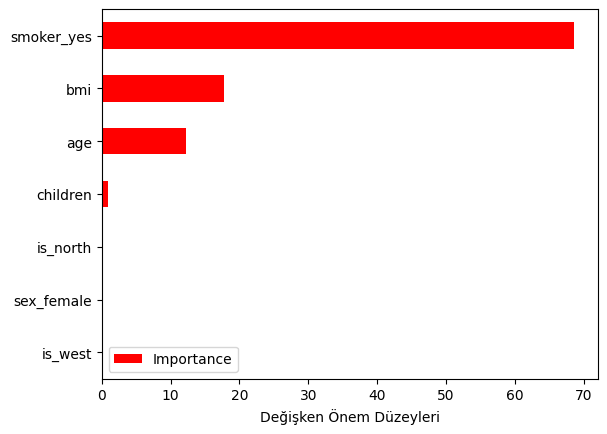

In [155]:
Importance.sort_values(by = "Importance", 
                       axis = 0, 
                       ascending = True).plot(kind ="barh", color = "r")

plt.xlabel("Değişken Önem Düzeyleri")

In [158]:
msre_gbm = np.sqrt(mean_squared_error(y_test, y_pred))
msre_gbm

4357.690929135165

In [159]:
r2_gbm = r2_score(y_test,y_pred)
r2_gbm

0.8776833251677247

# XGBoost

In [160]:
df = df_encoded
X = df.drop("charges", axis = 1)
y = df["charges"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state= 42)
print("X_train", X_train.shape)
print("y_train",y_train.shape)
print("X_test",X_test.shape)
print("y_test",y_test.shape)

X_train (1070, 7)
y_train (1070,)
X_test (268, 7)
y_test (268,)


In [161]:
import xgboost as xgb

In [162]:
DM_train = xgb.DMatrix(data = X_train, label = y_train)
DM_test = xgb.DMatrix(data = X_test, label = y_test)

In [163]:
from xgboost import XGBRegressor

In [164]:
xgb_model = XGBRegressor().fit(X_train, y_train)

In [165]:
y_pred = xgb_model.predict(X_test)
np.sqrt(mean_squared_error(y_test, y_pred))

5057.535153449027

## Tuning

In [166]:
xgb_grid = {
     'colsample_bytree': [0.4, 0.5,0.6,0.9,1], 
     'n_estimators':[100, 200, 500, 1000],
     'max_depth': [2,3,4,5,6],
     'learning_rate': [0.1, 0.01, 0.5]
}

In [167]:
xgb = XGBRegressor()

xgb_cv = GridSearchCV(xgb, 
                      param_grid = xgb_grid, 
                      cv = 10, 
                      n_jobs = -1,
                      verbose = 2)


xgb_cv.fit(X_train, y_train)

Fitting 10 folds for each of 300 candidates, totalling 3000 fits
[CV] END colsample_bytree=0.4, learning_rate=0.1, max_depth=2, n_estimators=100; total time=   0.0s
[CV] END colsample_bytree=0.4, learning_rate=0.1, max_depth=2, n_estimators=100; total time=   0.0s
[CV] END colsample_bytree=0.4, learning_rate=0.1, max_depth=2, n_estimators=100; total time=   0.0s
[CV] END colsample_bytree=0.4, learning_rate=0.1, max_depth=2, n_estimators=100; total time=   0.0s
[CV] END colsample_bytree=0.4, learning_rate=0.1, max_depth=2, n_estimators=100; total time=   0.0s
[CV] END colsample_bytree=0.4, learning_rate=0.1, max_depth=2, n_estimators=100; total time=   0.0s
[CV] END colsample_bytree=0.4, learning_rate=0.1, max_depth=2, n_estimators=100; total time=   0.0s
[CV] END colsample_bytree=0.4, learning_rate=0.1, max_depth=2, n_estimators=200; total time=   0.0s
[CV] END colsample_bytree=0.4, learning_rate=0.1, max_depth=2, n_estimators=200; total time=   0.0s
[CV] END colsample_bytree=0.4, lear

GridSearchCV(cv=10,
             estimator=XGBRegressor(base_score=None, booster=None,
                                    callbacks=None, colsample_bylevel=None,
                                    colsample_bynode=None,
                                    colsample_bytree=None, device=None,
                                    early_stopping_rounds=None,
                                    enable_categorical=False, eval_metric=None,
                                    feature_types=None, gamma=None,
                                    grow_policy=None, importance_type=None,
                                    interaction_constraints=None,
                                    learning_rate=None,...
                                    max_cat_to_onehot=None, max_delta_step=None,
                                    max_depth=None, max_leaves=None,
                                    min_child_weight=None, missing=nan,
                                    monotone_constraints=None,
                                    multi_strategy=None, n_estimators=None,
                                    n_jobs=None, num_parallel_tree=None,
                                    random_state=None, ...),
             n_jobs=-1,
             param_grid={'colsample_bytree': [0.4, 0.5, 0.6, 0.9, 1],
                         'learning_rate': [0.1, 0.01, 0.5],
                         'max_depth': [2, 3, 4, 5, 6],
                         'n_estimators': [100, 200, 500, 1000]},
             verbose=2)

In [168]:
xgb_cv.best_params_

{'colsample_bytree': 0.9,
 'learning_rate': 0.1,
 'max_depth': 2,
 'n_estimators': 100}

In [169]:
xgb_grid_adjusted = {
    'colsample_bytree': [0.8, 0.9, 1.0],  # Adjusted based on the best value (0.9)
    'n_estimators': [50, 100, 200],       # Adjusted based on the best value (100)
    'max_depth': [1, 2, 3],                # Adjusted based on the best value (2)
    'learning_rate': [0.05, 0.1, 0.15]     # Adjusted based on the best value (0.1)
}

In [170]:
xgb = XGBRegressor()

xgb_cv = GridSearchCV(xgb, 
                      param_grid = xgb_grid_adjusted, 
                      cv = 10, 
                      n_jobs = -1,
                      verbose = 2)


xgb_cv.fit(X_train, y_train)

Fitting 10 folds for each of 81 candidates, totalling 810 fits
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=1, n_estimators=50; total time=   0.0s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=1, n_estimators=50; total time=   0.0s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=1, n_estimators=50; total time=   0.0s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=1, n_estimators=50; total time=   0.0s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=1, n_estimators=50; total time=   0.0s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=1, n_estimators=50; total time=   0.0s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=1, n_estimators=50; total time=   0.0s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=1, n_estimators=50; total time=   0.0s
[CV] END colsample_bytree=0.8, learning_rate=0.05, max_depth=1, n_estimators=50; total time=   0.0s
[CV] END colsample_bytree=0.8, learni

GridSearchCV(cv=10,
             estimator=XGBRegressor(base_score=None, booster=None,
                                    callbacks=None, colsample_bylevel=None,
                                    colsample_bynode=None,
                                    colsample_bytree=None, device=None,
                                    early_stopping_rounds=None,
                                    enable_categorical=False, eval_metric=None,
                                    feature_types=None, gamma=None,
                                    grow_policy=None, importance_type=None,
                                    interaction_constraints=None,
                                    learning_rate=None,...
                                    max_cat_to_onehot=None, max_delta_step=None,
                                    max_depth=None, max_leaves=None,
                                    min_child_weight=None, missing=nan,
                                    monotone_constraints=None,
                                    multi_strategy=None, n_estimators=None,
                                    n_jobs=None, num_parallel_tree=None,
                                    random_state=None, ...),
             n_jobs=-1,
             param_grid={'colsample_bytree': [0.8, 0.9, 1.0],
                         'learning_rate': [0.05, 0.1, 0.15],
                         'max_depth': [1, 2, 3],
                         'n_estimators': [50, 100, 200]},
             verbose=2)

In [171]:
xgb_cv.best_params_

{'colsample_bytree': 0.9,
 'learning_rate': 0.1,
 'max_depth': 2,
 'n_estimators': 100}

In [172]:
xgb_tuned = XGBRegressor(colsample_bytree = 0.9, 
                         learning_rate = 0.1, 
                         max_depth = 2, 
                         n_estimators = 100) 

xgb_tuned = xgb_tuned.fit(X_train,y_train)

In [175]:
y_pred = xgb_tuned.predict(X_test)
msre_xgb = np.sqrt(mean_squared_error(y_test, y_pred))
msre_xgb

4367.853888327077

In [176]:
r2_xgb = r2_score(y_test,y_pred)
r2_xgb

0.8771121286480807

# Light GBM

In [190]:
df = df_encoded
X = df.drop("charges", axis = 1)
y = df["charges"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state= 42)
print("X_train", X_train.shape)
print("y_train",y_train.shape)
print("X_test",X_test.shape)
print("y_test",y_test.shape)

X_train (1070, 7)
y_train (1070,)
X_test (268, 7)
y_test (268,)


In [191]:
from lightgbm import LGBMRegressor

In [192]:
lgbm = LGBMRegressor()
lgbm_model = lgbm.fit(X_train, y_train)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000707 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 95
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 7
[LightGBM] [Info] Start training from score 13345.596262


In [193]:
y_pred = lgbm_model.predict(X_test, 
                            num_iteration = lgbm_model.best_iteration_)

In [194]:
np.sqrt(mean_squared_error(y_test, y_pred))

4558.585057948897

## Tuning

In [195]:
lgbm_grid = {
    'colsample_bytree': [0.5,0.9,1],
    'learning_rate': [0.01, 0.5,1],
    'n_estimators': [40, 100, 200, 500],
    'max_depth': [2,3,4,5,6] }

lgbm = LGBMRegressor()
lgbm_cv_model = GridSearchCV(lgbm, lgbm_grid, cv=10, n_jobs = -1, verbose = 2)

In [296]:
lgbm_cv_model.fit(X_train, y_train)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000810 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 94
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000872 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 94
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 7
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 7
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001153 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 95
[LightGBM] [Info] Start training from score 13301.288681
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 7
[LightGBM] [Info] Start tr

KeyboardInterrupt: 

In [ ]:
lgbm_cv_model.best_params_

In [213]:
lgbm_tuned = LGBMRegressor(learning_rate = 0.1, 
                           max_depth = 7, 
                           n_estimators = 40,
                          colsample_bytree = 0.6,
                          num_leaves=6)

lgbm_tuned = lgbm_tuned.fit(X_train,y_train)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000362 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 95
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 7
[LightGBM] [Info] Start training from score 13345.596262


In [214]:
y_pred = lgbm_tuned.predict(X_test)

In [217]:
msre_lgbm = np.sqrt(mean_squared_error(y_test, y_pred))
msre_lgbm

5078.945289207876

In [218]:
r2_lgbm = r2_score(y_test,y_pred)
r2_lgbm

0.8338425239864495

# CatBoost

In [177]:
df = df_encoded
X = df.drop("charges", axis = 1)
y = df["charges"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state= 42)
print("X_train", X_train.shape)
print("y_train",y_train.shape)
print("X_test",X_test.shape)
print("y_test",y_test.shape)

X_train (1070, 7)
y_train (1070,)
X_test (268, 7)
y_test (268,)


In [178]:
from catboost import CatBoostRegressor

In [179]:
catb = CatBoostRegressor()
catb_model = catb.fit(X_train, y_train)

Learning rate set to 0.041383
0:	learn: 11647.1846371	total: 59.2ms	remaining: 59.2s
1:	learn: 11278.6571863	total: 59.6ms	remaining: 29.7s
2:	learn: 10950.1043813	total: 59.9ms	remaining: 19.9s
3:	learn: 10624.7037453	total: 60.2ms	remaining: 15s
4:	learn: 10301.4701046	total: 60.4ms	remaining: 12s
5:	learn: 9999.7921542	total: 60.7ms	remaining: 10.1s
6:	learn: 9738.2345008	total: 61ms	remaining: 8.65s
7:	learn: 9467.9218497	total: 61.3ms	remaining: 7.6s
8:	learn: 9208.4832535	total: 61.6ms	remaining: 6.78s
9:	learn: 8960.2642201	total: 61.9ms	remaining: 6.13s
10:	learn: 8740.4086543	total: 62.1ms	remaining: 5.58s
11:	learn: 8510.4998347	total: 62.4ms	remaining: 5.14s
12:	learn: 8293.8645846	total: 62.7ms	remaining: 4.76s
13:	learn: 8107.0536234	total: 63ms	remaining: 4.44s
14:	learn: 7908.9829109	total: 63.3ms	remaining: 4.16s
15:	learn: 7708.6112968	total: 63.6ms	remaining: 3.91s
16:	learn: 7518.5712737	total: 63.8ms	remaining: 3.69s
17:	learn: 7343.9836402	total: 64.1ms	remaining: 

In [180]:
y_pred = catb_model.predict(X_test)
np.sqrt(mean_squared_error(y_test, y_pred))

4852.61704477347

## Tuning

In [181]:
catb_grid = {
    'iterations': [50,100,200,250],
    'learning_rate': [0.04, 0.05, 0.6],
    'depth': [1,2,3,4] }

In [182]:
catb = CatBoostRegressor()
catb_cv_model = GridSearchCV(catb, catb_grid, cv=5, n_jobs = -1, verbose = 2)

In [183]:
catb_cv_model.fit(X_train, y_train)

Fitting 5 folds for each of 48 candidates, totalling 240 fits
0:	learn: 11665.8592954	total: 51.9ms	remaining: 2.54s
1:	learn: 11400.8793491	total: 52ms	remaining: 1.25s
2:	learn: 11150.8114920	total: 52.2ms	remaining: 817ms
3:	learn: 10915.0055095	total: 52.2ms	remaining: 601ms
4:	learn: 10692.8272596	total: 52.3ms	remaining: 471ms
5:	learn: 10483.6584853	total: 52.4ms	remaining: 384ms
6:	learn: 10286.8967260	total: 52.6ms	remaining: 323ms
7:	learn: 10101.9553181	total: 52.7ms	remaining: 277ms
8:	learn: 9928.2634677	total: 52.8ms	remaining: 240ms
9:	learn: 9765.2663815	total: 52.9ms	remaining: 212ms
10:	learn: 9612.4254403	total: 53ms	remaining: 188ms
11:	learn: 9469.2183982	total: 53.1ms	remaining: 168ms
12:	learn: 9335.1395929	total: 53.1ms	remaining: 151ms
13:	learn: 9209.7001521	total: 53.2ms	remaining: 137ms
14:	learn: 9092.4281824	total: 53.2ms	remaining: 124ms
15:	learn: 8982.8689292	total: 53.4ms	remaining: 113ms
16:	learn: 8880.5848975	total: 53.5ms	remaining: 104ms
0:	learn:

GridSearchCV(cv=5,
             estimator=<catboost.core.CatBoostRegressor object at 0x30a434450>,
             n_jobs=-1,
             param_grid={'depth': [1, 2, 3, 4],
                         'iterations': [50, 100, 200, 250],
                         'learning_rate': [0.04, 0.05, 0.6]},
             verbose=2)

In [184]:
catb_cv_model.best_params_

{'depth': 3, 'iterations': 250, 'learning_rate': 0.04}

Initial: {'depth': 3, 'iterations': 200, 'learning_rate': 0.05}


In [185]:
catb_tuned = CatBoostRegressor(iterations = 200, 
                               learning_rate = 0.04, 
                               depth = 3)

catb_tuned = catb_tuned.fit(X_train,y_train)

0:	learn: 11681.2445797	total: 833us	remaining: 166ms
1:	learn: 11340.5649249	total: 971us	remaining: 96.1ms
2:	learn: 11008.1265683	total: 1.07ms	remaining: 70.1ms
3:	learn: 10674.2962942	total: 1.92ms	remaining: 93.9ms
4:	learn: 10364.6724810	total: 2.42ms	remaining: 94.2ms
5:	learn: 10054.4864856	total: 2.51ms	remaining: 81.1ms
6:	learn: 9777.7217820	total: 2.6ms	remaining: 71.8ms
7:	learn: 9495.7496315	total: 2.69ms	remaining: 64.6ms
8:	learn: 9254.4689658	total: 2.78ms	remaining: 59ms
9:	learn: 9014.5351675	total: 2.87ms	remaining: 54.5ms
10:	learn: 8811.0913968	total: 2.96ms	remaining: 50.9ms
11:	learn: 8581.9037639	total: 3.05ms	remaining: 47.8ms
12:	learn: 8397.6782183	total: 3.18ms	remaining: 45.8ms
13:	learn: 8203.5619692	total: 3.28ms	remaining: 43.6ms
14:	learn: 8017.0984010	total: 3.43ms	remaining: 42.3ms
15:	learn: 7830.5267141	total: 3.56ms	remaining: 40.9ms
16:	learn: 7650.3748937	total: 3.65ms	remaining: 39.3ms
17:	learn: 7501.1036211	total: 3.74ms	remaining: 37.8ms
18

In [188]:
y_pred = catb_tuned.predict(X_test)
msre_catb = np.sqrt(mean_squared_error(y_test, y_pred))
msre_catb

4289.977492090577

Initial 4289.687185704645

In [189]:
r2_catb = r2_score(y_test,y_pred)
r2_catb

0.8814551082213415

# Results

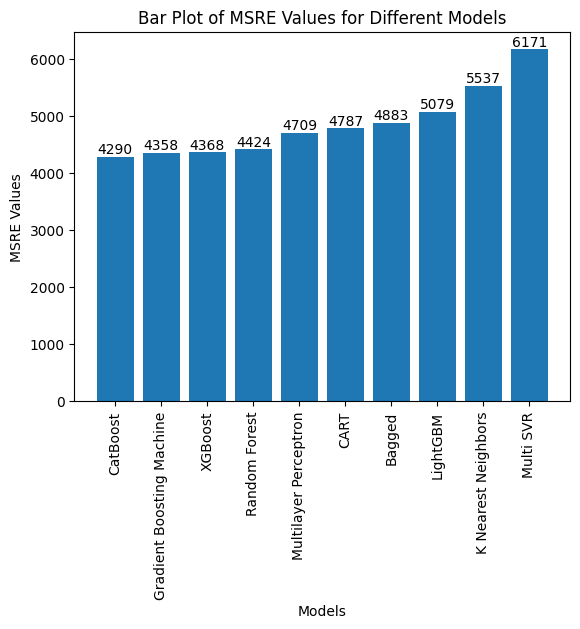

In [227]:
variables = ['Bagged', 'CART', 'CatBoost', 'Gradient Boosting Machine', 'K Nearest Neighbors', 'LightGBM', 'Multilayer Perceptron', 'Multi SVR', 'Random Forest', 'XGBoost']
values = [msre_bagged, msre_cart, msre_catb, msre_gbm, msre_knn, msre_lgbm, msre_mlp, msre_multi_svr, msre_randomf, msre_xgb]

sorted_data = sorted(zip(variables, values), key=lambda x: x[1])

sorted_variables, sorted_values = zip(*sorted_data)

plt.bar(sorted_variables, sorted_values)

plt.xlabel('Models')
plt.ylabel('MSRE Values')
plt.title('Bar Plot of MSRE Values for Different Models')
plt.xticks(rotation=90)

for i, value in enumerate(sorted_values):
    plt.text(i, value, f'{value:.0f}', ha='center', va='bottom')

plt.show()

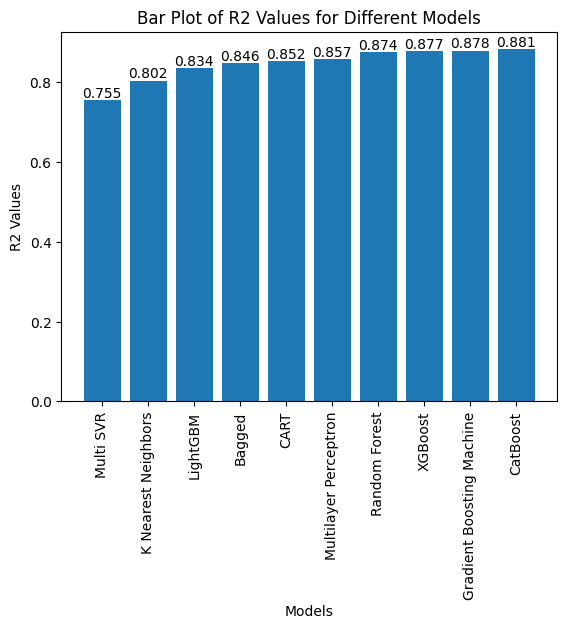

In [225]:
variables = ['Bagged', 'CART', 'CatBoost', 'Gradient Boosting Machine', 'K Nearest Neighbors', 'LightGBM', 'Multilayer Perceptron', 'Multi SVR', 'Random Forest', 'XGBoost']
values = [r2_bagged, r2_cart, r2_catb, r2_gbm, r2_knn, r2_lgbm, r2_mlp, r2_multi_svr, r2_randomf, r2_xgb]

sorted_data = sorted(zip(variables, values), key=lambda x: x[1])

sorted_variables, sorted_values = zip(*sorted_data)

plt.bar(sorted_variables, sorted_values)

plt.xlabel('Models')
plt.ylabel('R2 Values')
plt.title('Bar Plot of R2 Values for Different Models')
plt.xticks(rotation=90)

for i, value in enumerate(sorted_values):
    plt.text(i, value, f'{value:.3f}', ha='center', va='bottom')


plt.show()